In [46]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy import stats
import qdatoolkit as qda

data = pd.read_csv('./data/layer_324.csv')

data.head()

,t,x,y,z,layer_id,sensor0,sensor1,temp,track_id,track_orient,pos_rel,t_rel
0,1.2730e+08,26.035,-66.386,12.96,324,800.0,795.0,1594.7,0,131,0.0000,0.0
1,1.2730e+08,26.043,-66.392,12.96,324,798.0,794.0,1593.3,0,131,0.0082,10.0
2,1.2730e+08,26.047,-66.398,12.96,324,814.0,799.0,1608.5,0,131,0.0164,20.0
3,1.2730e+08,26.049,-66.404,12.96,324,829.0,806.0,1619.4,0,131,0.0246,30.0
4,1.2730e+08,26.057,-66.412,12.96,324,833.0,824.0,1599.8,0,131,0.0328,40.0


Runs test statistic = -227.133
Runs test p-value = 0.000



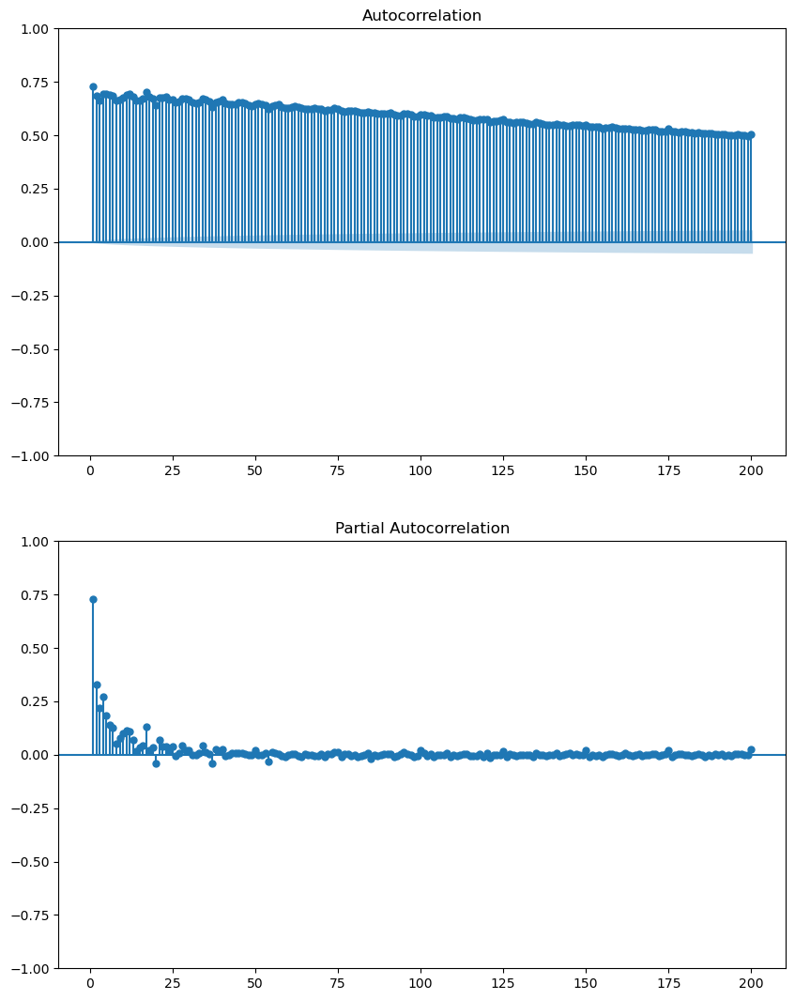

(-227.13295162929526, 0.0)


In [3]:

# Perform the runs test for independence on the 'temp' column
result = qda.Assumptions(data['temp']).independence()

# Display the result
print(result)

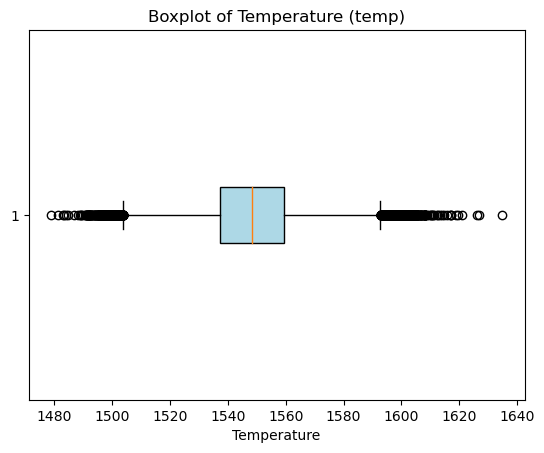

In [64]:
import matplotlib.pyplot as plt

# Create a boxplot for the 'temp' column
plt.boxplot(data['temp'], vert=False, patch_artist=True, boxprops=dict(facecolor='lightblue'))

# Add labels and title
plt.xlabel('Temperature')
plt.title('Boxplot of Temperature (temp)')

# Show the plot
plt.show()

In [66]:
# Calculate Q1 (25th percentile) and Q3 (75th percentile)
Q1 = data['temp'].quantile(0.25)
Q3 = data['temp'].quantile(0.75)

# Calculate the Interquartile Range (IQR)
IQR = Q3 - Q1

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = data[(data['temp'] < lower_bound) | (data['temp'] > upper_bound)]

# Count the number of outliers
num_outliers = len(outliers)

# Print the results
print(f"Lower bound: {lower_bound}")
print(f"Upper bound: {upper_bound}")
print(f"Number of outliers: {num_outliers}")

Lower bound: 1503.9
Upper bound: 1592.7000000000003
Number of outliers: 1093


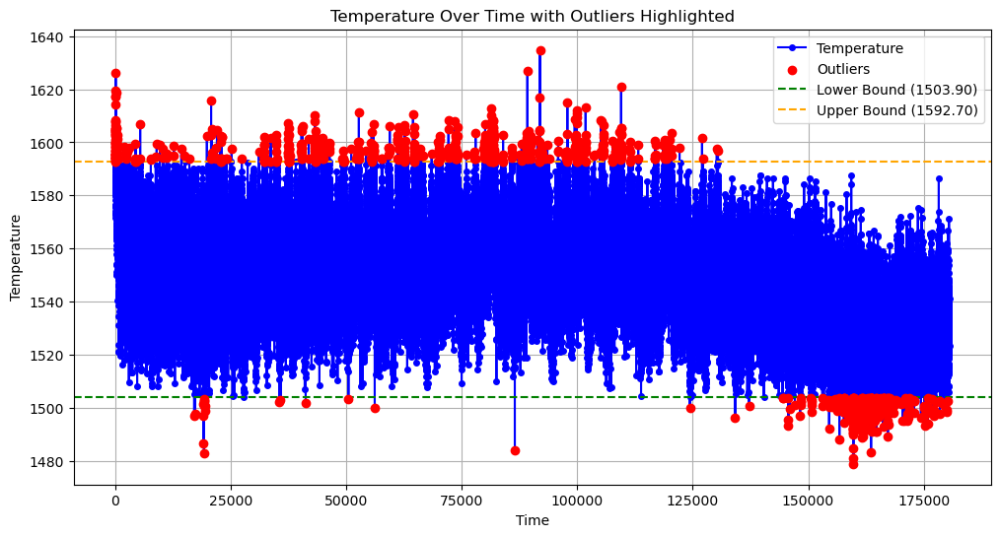

In [67]:
import matplotlib.pyplot as plt

# Calculate Q1, Q3, and IQR
Q1 = data['temp'].quantile(0.25)
Q3 = data['temp'].quantile(0.75)
IQR = Q3 - Q1

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = (data['temp'] < lower_bound) | (data['temp'] > upper_bound)

# Plot the temperature over time
plt.figure(figsize=(12, 6))
plt.plot(data.index, data['temp'], label='Temperature', color='blue', marker='o', linestyle='-', markersize=4)

# Highlight outliers in red
plt.scatter(data.index[outliers], data['temp'][outliers], color='red', label='Outliers', zorder=5)

# Add the lower and upper bounds as horizontal lines
plt.axhline(y=lower_bound, color='green', linestyle='--', label=f'Lower Bound ({lower_bound:.2f})')
plt.axhline(y=upper_bound, color='orange', linestyle='--', label=f'Upper Bound ({upper_bound:.2f})')

# Add labels, title, and legend
plt.xlabel('Time')
plt.ylabel('Temperature')
plt.title('Temperature Over Time with Outliers Highlighted')
plt.legend()
plt.grid()

# Show the plot
plt.show()

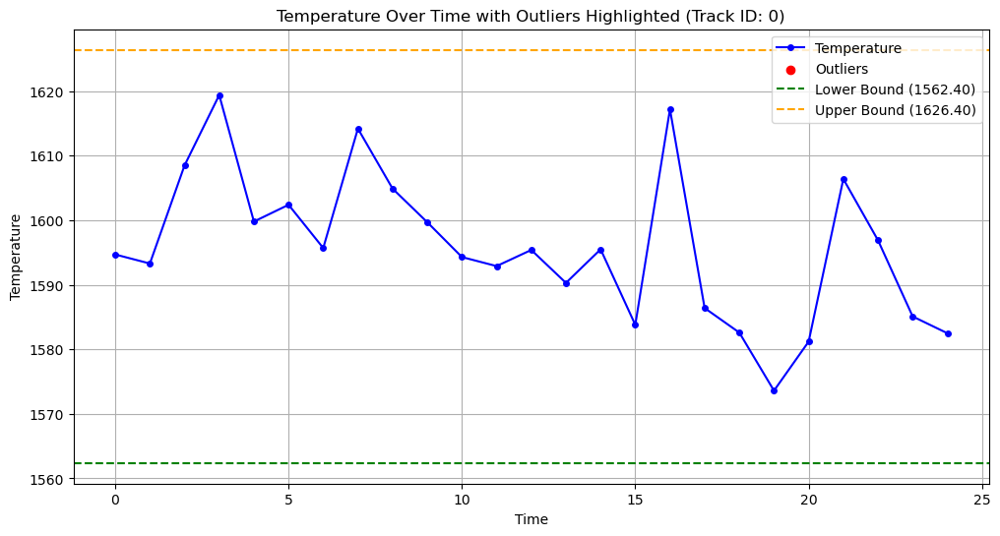

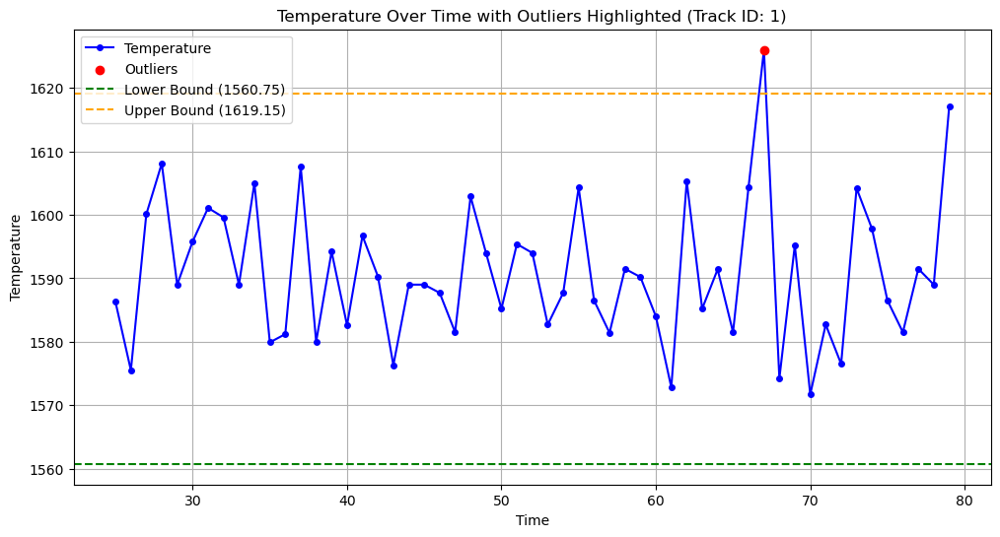

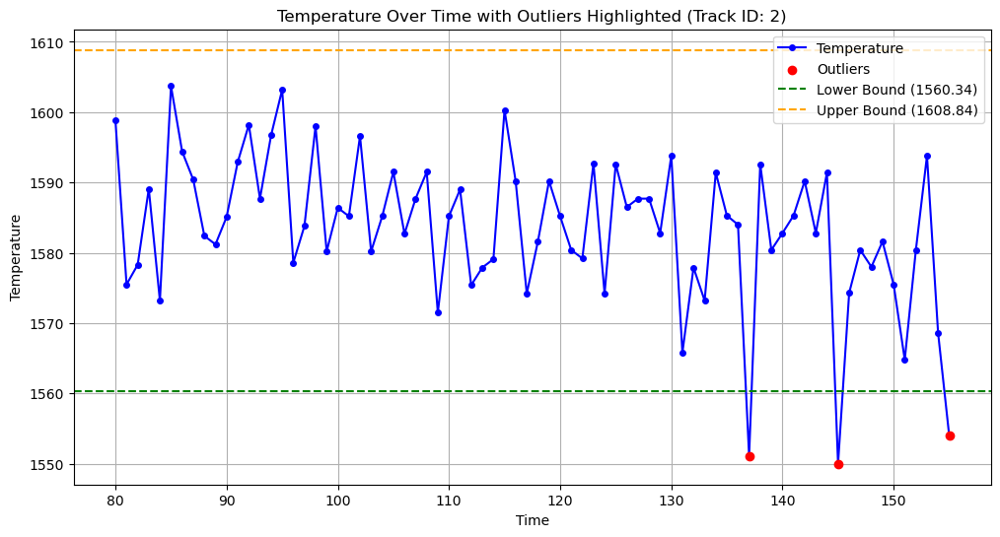

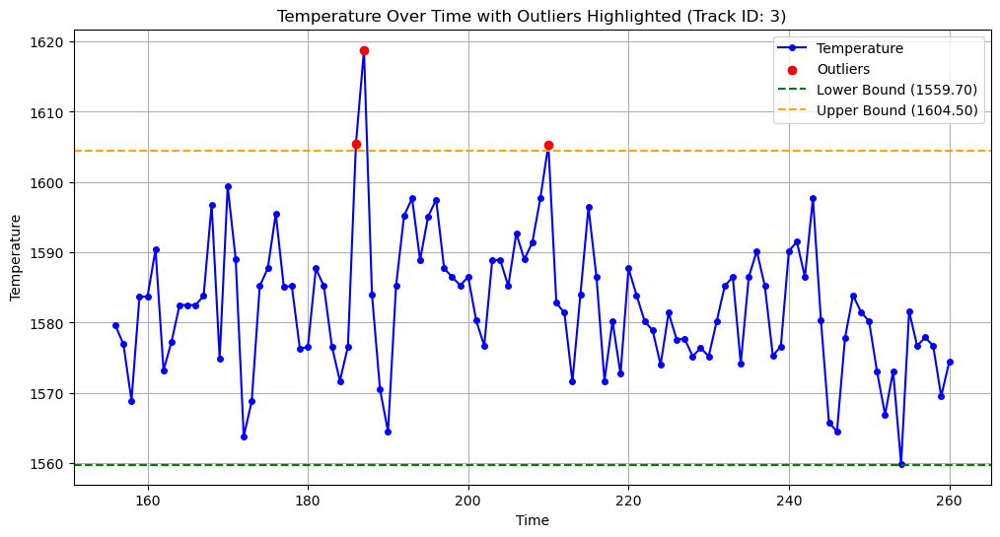

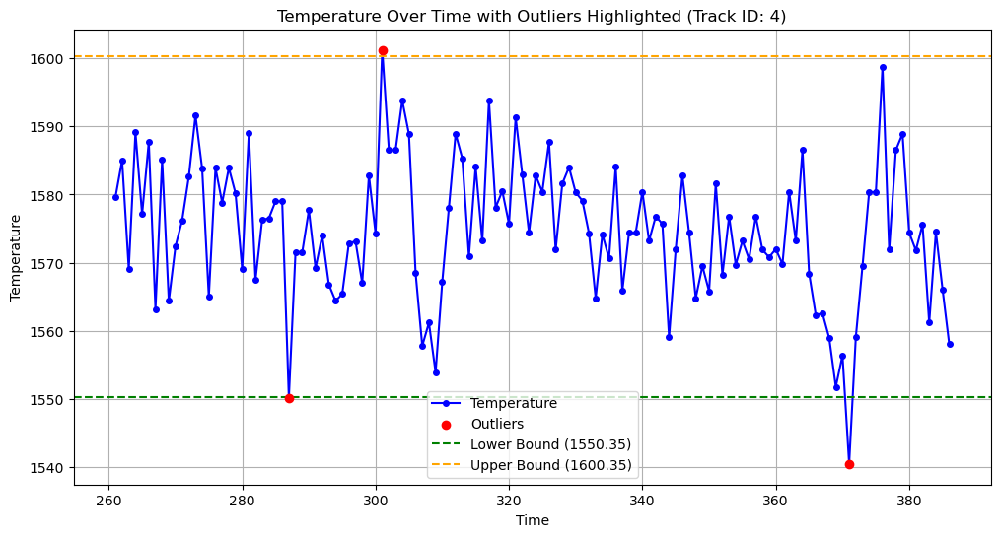

...

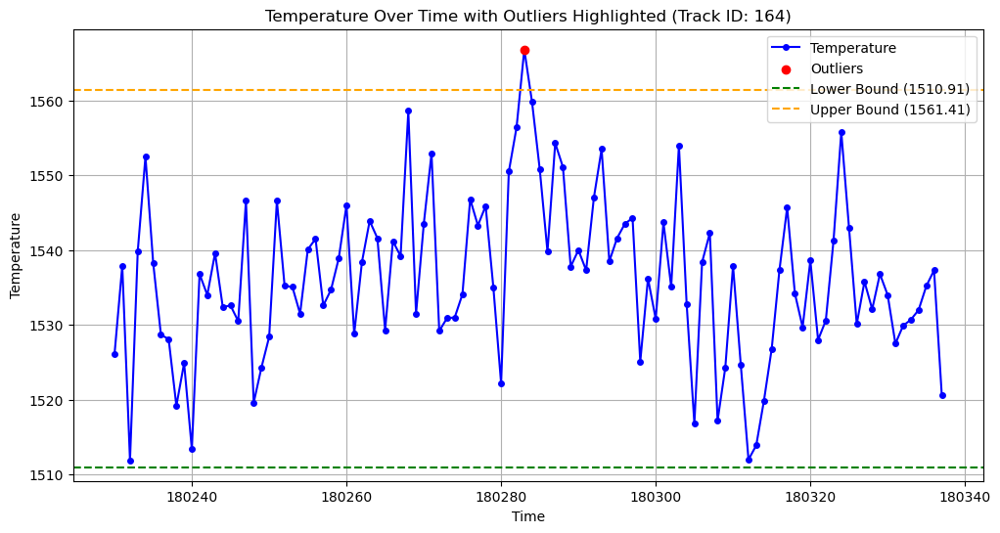

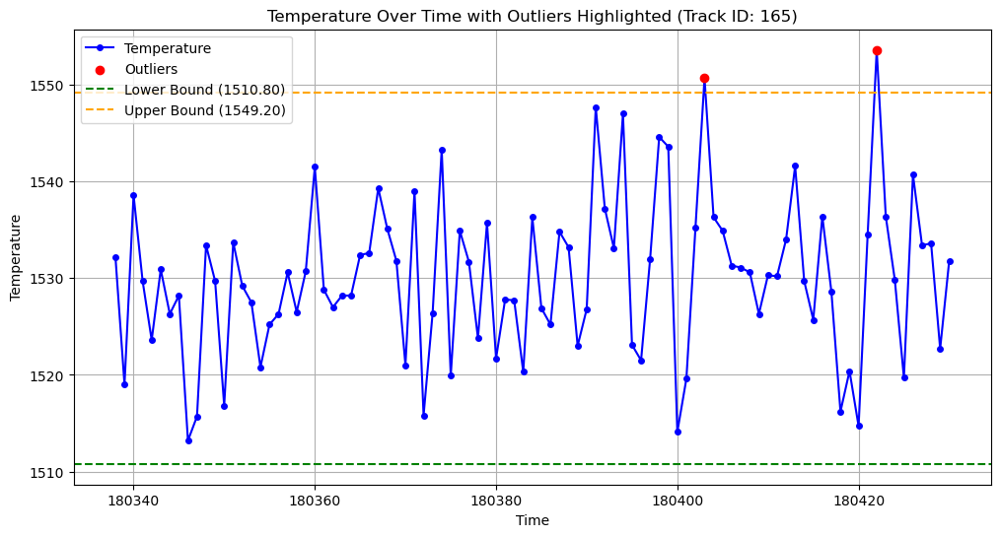

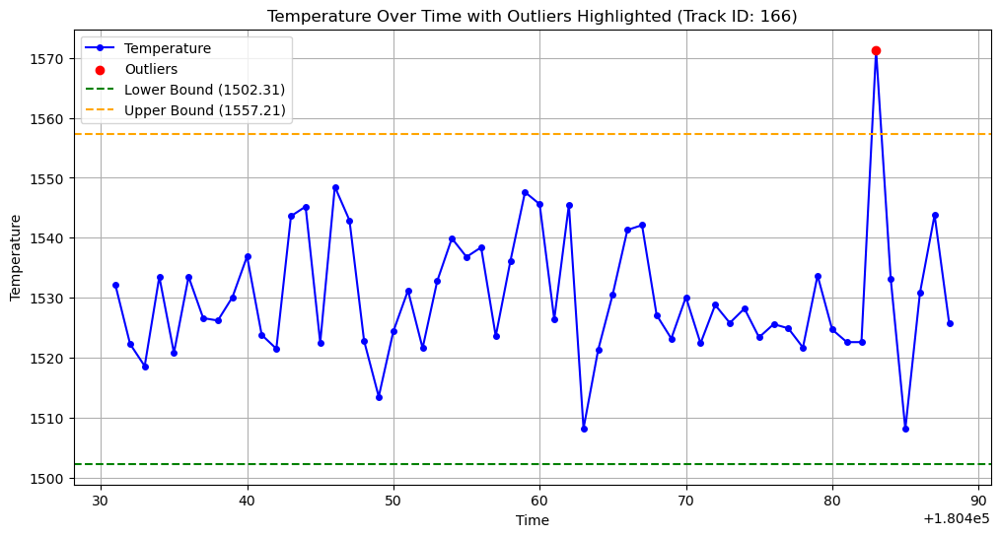

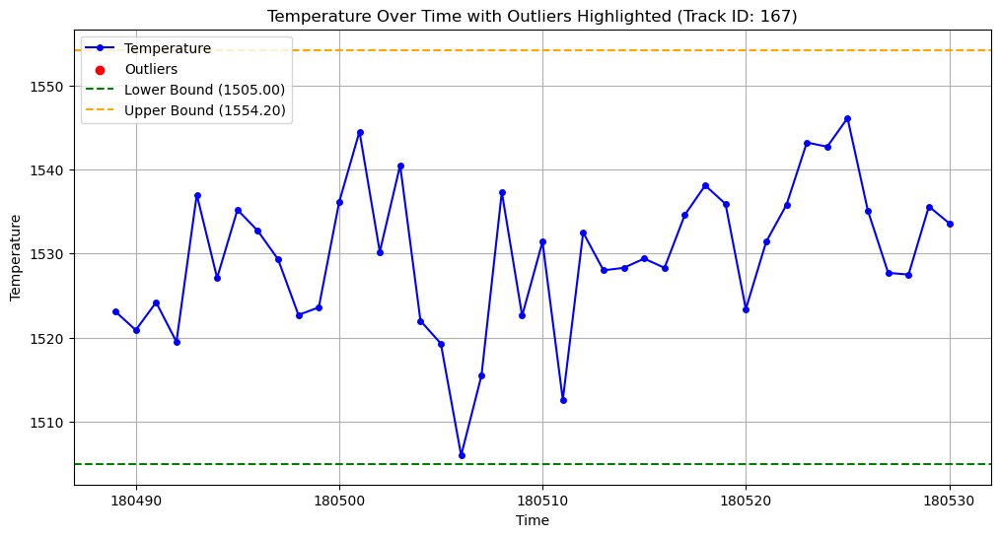

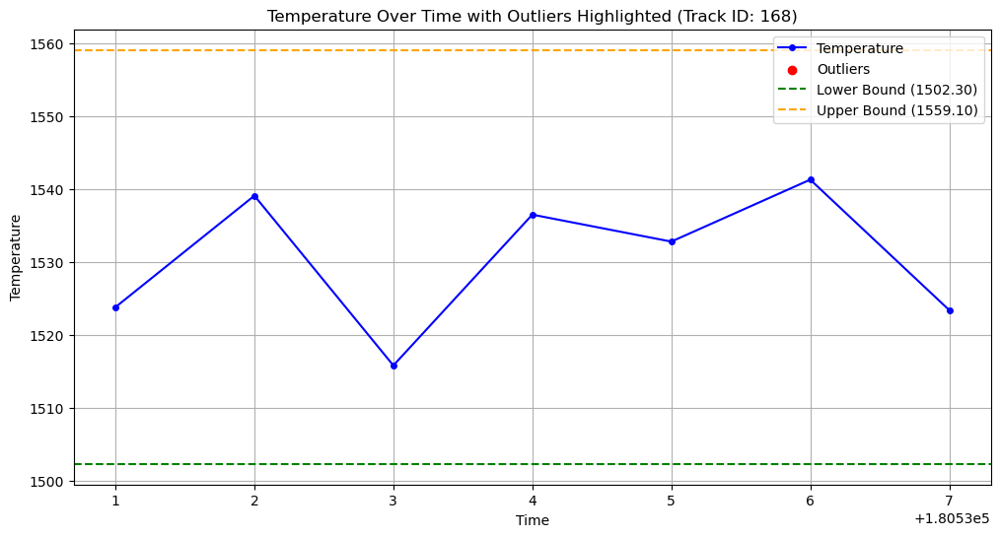

In [68]:
# Group the data by 'track_id' and create a plot for each group
for track_id, group in data.groupby('track_id'):
    # Calculate Q1, Q3, and IQR for the current group
    Q1 = group['temp'].quantile(0.25)
    Q3 = group['temp'].quantile(0.75)
    IQR = Q3 - Q1

    # Define the lower and upper bounds for outliers
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Identify outliers
    outliers = (group['temp'] < lower_bound) | (group['temp'] > upper_bound)

    # Plot the temperature over time for the current track_id
    plt.figure(figsize=(12, 6))
    plt.plot(group.index, group['temp'], label='Temperature', color='blue', marker='o', linestyle='-', markersize=4)

    # Highlight outliers in red
    plt.scatter(group.index[outliers], group['temp'][outliers], color='red', label='Outliers', zorder=5)

    # Add the lower and upper bounds as horizontal lines
    plt.axhline(y=lower_bound, color='green', linestyle='--', label=f'Lower Bound ({lower_bound:.2f})')
    plt.axhline(y=upper_bound, color='orange', linestyle='--', label=f'Upper Bound ({upper_bound:.2f})')

    # Add labels, title, and legend
    plt.xlabel('Time')
    plt.ylabel('Temperature')
    plt.title(f'Temperature Over Time with Outliers Highlighted (Track ID: {track_id})')
    plt.legend()
    plt.grid()

    # Show the plot
    plt.show()

tentativo di tcl

Reduced dataset size: 4880 rows


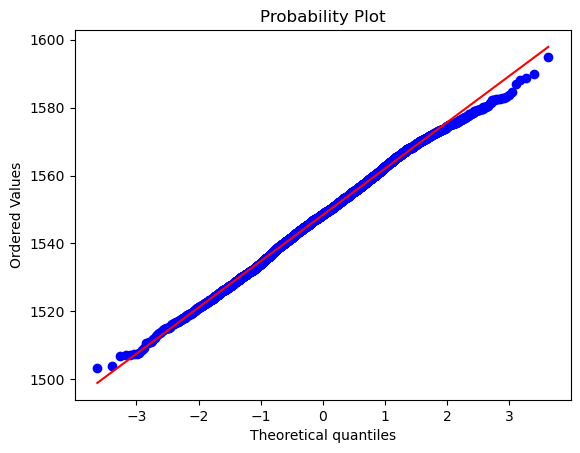

Shapiro-wilk test statistic = 0.998
Shapiro-wilk test p-value = 0.000


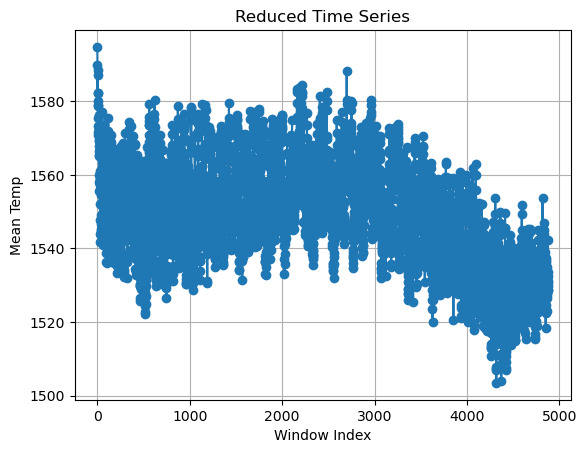

In [58]:
import numpy as np
import matplotlib.pyplot as plt

# Define the maximum number of rows for the reduced dataset
max_rows = 5000

# Calculate the appropriate window size
window_size = int(np.ceil(len(data) / max_rows))

# Divide the time series into non-overlapping windows
data['window'] = data.index // window_size

# Compute the mean for each window
grouped_data = data.groupby('window')['temp'].mean().reset_index(name='temp_mean')

# Verify the reduced dataset size
print(f"Reduced dataset size: {len(grouped_data)} rows")

# Check normality of the reduced dataset
_ = qda.Assumptions(grouped_data['temp_mean']).normality()

# Plot the reduced dataset
plt.plot(grouped_data['temp_mean'], 'o-')
plt.xlabel('Window Index')
plt.ylabel('Mean Temp')
plt.title('Reduced Time Series')
plt.grid()
plt.show()

AttributeError: 'Assumptions' object has no attribute 'boxplot'

tentativo riduzione del dataset randomicamente

In [34]:

data1 = data.sample(n=5000, random_state=42)  # Randomly sample 5000 rows


# Riordina i dati in ordine crescente considerando i valori della prima colonna
data1 = data1.sort_values(by=data1.columns[0])
data1.reset_index(drop=True, inplace=True)

data1.head()


,t,x,y,z,layer_id,sensor0,sensor1,temp,track_id,track_orient,pos_rel,t_rel
0,1.2730e+08,26.160,-66.522,12.96,324,847.0,840.0,1596.9,0,131,0.1806,220.0
1,1.2730e+08,26.357,-66.613,12.96,324,849.0,848.0,1589.0,1,131,0.0572,80.0
2,1.2730e+08,26.348,-66.597,12.96,324,846.0,852.0,1579.9,1,131,0.0714,100.0
3,1.2730e+08,26.258,-66.493,12.96,324,872.0,872.0,1587.7,1,131,0.2072,290.0
4,1.2730e+08,26.148,-66.208,12.96,324,874.0,876.0,1585.2,2,131,0.1687,210.0


Runs test statistic = -30.974
Runs test p-value = 0.000



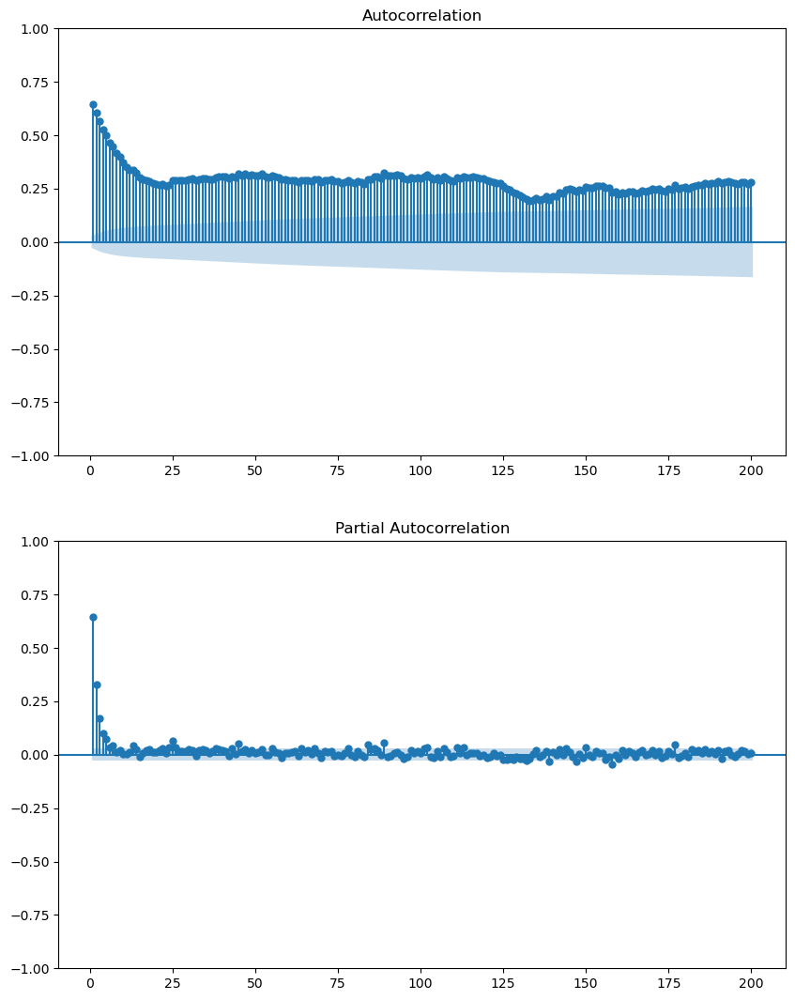

In [35]:
_=qda.Assumptions(data1['temp']).independence()

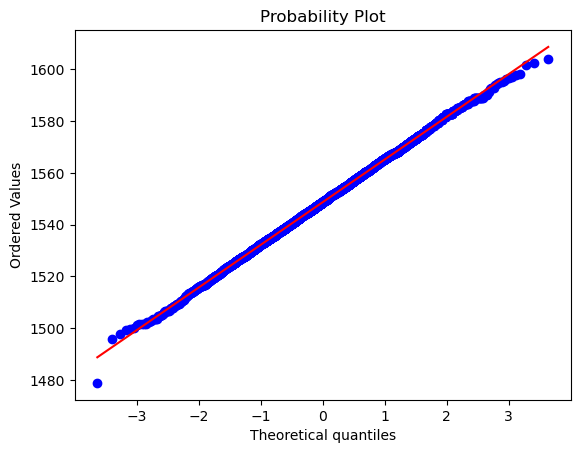

Shapiro-wilk test statistic = 1.000
Shapiro-wilk test p-value = 0.763


In [36]:
_=qda.Assumptions(data1['temp']).normality()

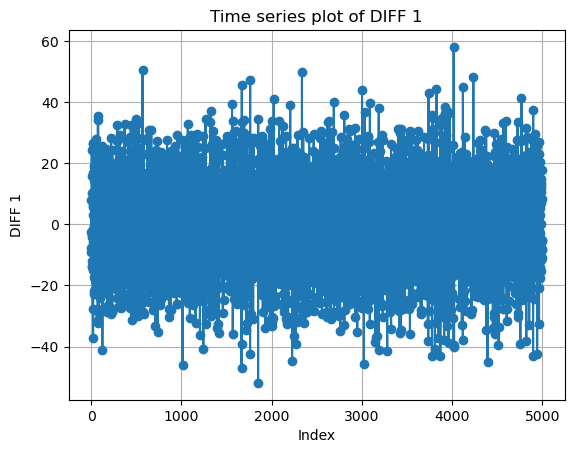

In [37]:
data1['diff1'] = data1['temp'].diff(1)

plt.plot(data1['diff1'], 'o-')
plt.xlabel('Index')
plt.ylabel('DIFF 1')
plt.title('Time series plot of DIFF 1')
plt.grid()
plt.show()

Runs test statistic = 20.953
Runs test p-value = 0.000



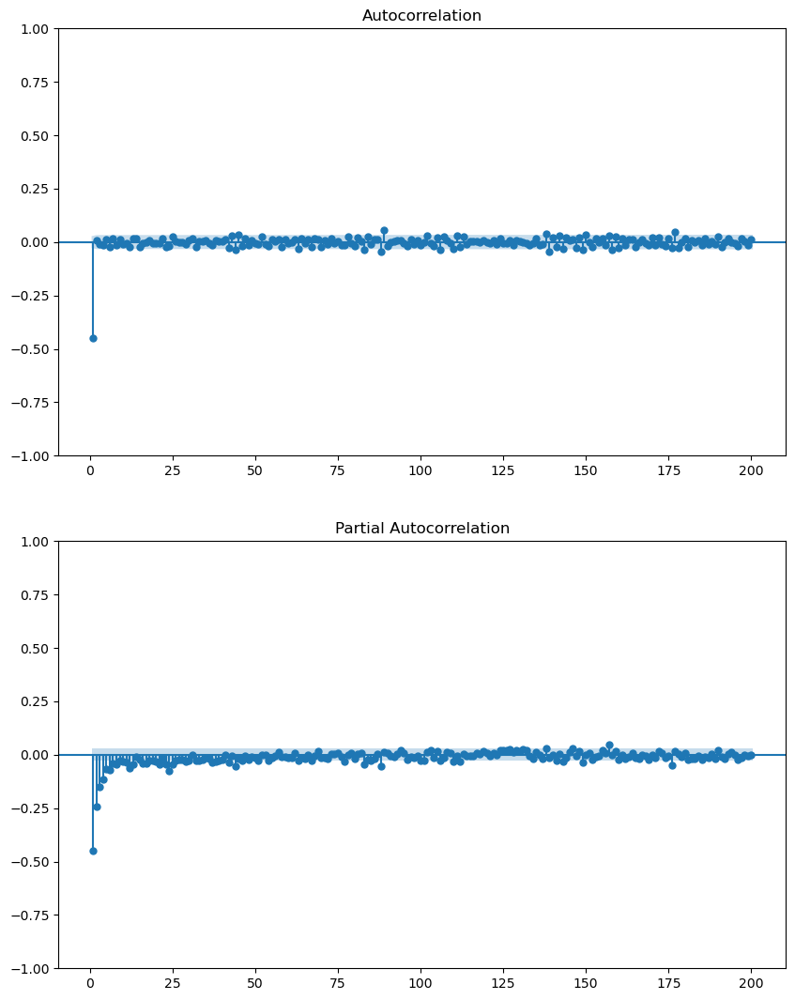

In [38]:
_ = qda.Assumptions(data1['diff1']).independence()

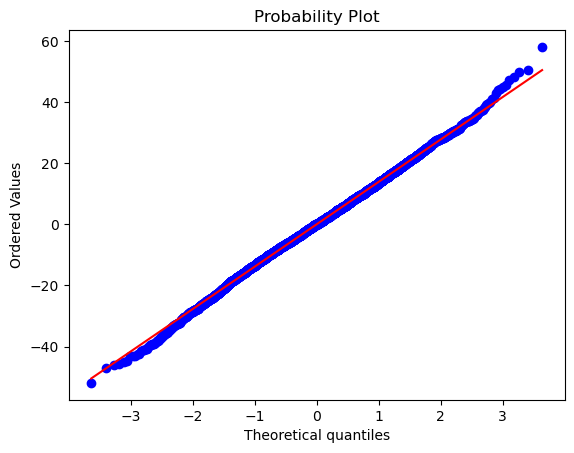

Shapiro-wilk test statistic = 0.999
Shapiro-wilk test p-value = 0.006


In [39]:
_ = qda.Assumptions(data1['diff1']).normality()

In [40]:
# fit model ARIMA with constant term
model1 = qda.ARIMA(data1['temp'], order=(0,1,1), add_constant=True)

qda.ARIMAsummary(model1)

---------------------
ARIMA MODEL RESULTS
---------------------
ARIMA model order: p=0, d=1, q=1

FINAL ESTIMATES OF PARAMETERS
-------------------------------
 Term    Coef  SE Coef  T-Value  P-Value
const -0.0106   0.0574  -0.1844   0.8537
ma.L1 -0.6546   0.0106 -61.5716   0.0000

RESIDUAL SUM OF SQUARES
-------------------------
    DF          SS       MS
4997.0 689849.0338 138.0526

Ljung-Box Chi-Square Statistics
----------------------------------
 Lag  Chi-Square    P-Value
  12     61.8796 1.0233e-08
  24    102.4002 1.1673e-11
  36    109.4835 2.4155e-09
  48    121.5746 2.6040e-08


In [41]:
# fit model ARIMA with constant term
model2 = qda.ARIMA(data1['temp'], order=(0,1,1), add_constant=False)

qda.ARIMAsummary(model2)

---------------------
ARIMA MODEL RESULTS
---------------------
ARIMA model order: p=0, d=1, q=1

FINAL ESTIMATES OF PARAMETERS
-------------------------------
 Term    Coef  SE Coef  T-Value  P-Value
ma.L1 -0.6546   0.0106 -61.6022      0.0

RESIDUAL SUM OF SQUARES
-------------------------
    DF          SS      MS
4998.0 689853.8005 138.026

Ljung-Box Chi-Square Statistics
----------------------------------
 Lag  Chi-Square    P-Value
  12     61.8798 1.0232e-08
  24    102.4001 1.1673e-11
  36    109.4833 2.4157e-09
  48    121.5744 2.6042e-08


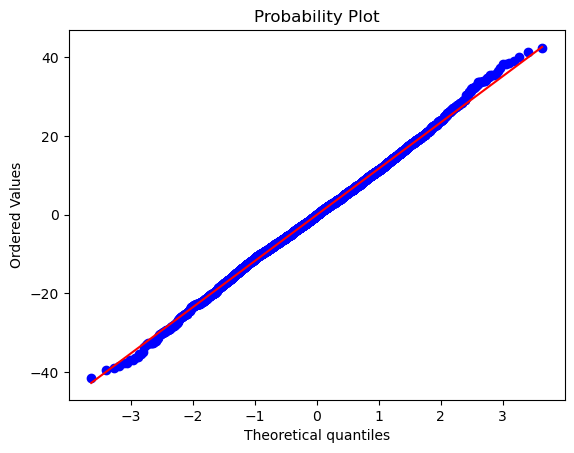

Shapiro-wilk test statistic = 0.999
Shapiro-wilk test p-value = 0.001


In [42]:
#extract the residuals
residuals = model2.resid[1:] 

# Perform the Shapiro-Wilk test
_ = qda.Assumptions(residuals).normality()

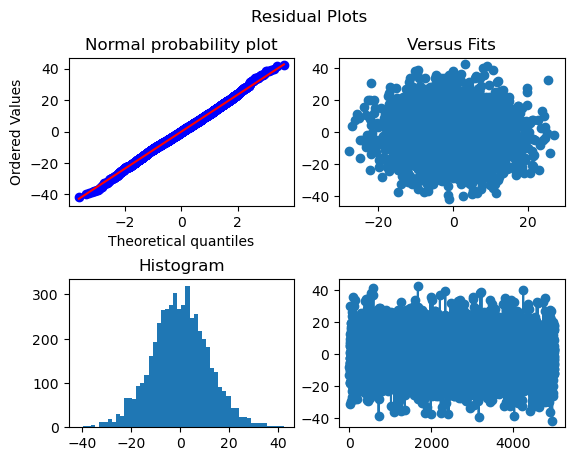

In [43]:
fig, axs = plt.subplots(2, 2)
fig.suptitle('Residual Plots')
stats.probplot(residuals, dist="norm", plot=axs[0,0])
axs[0,0].set_title('Normal probability plot')
axs[0,1].scatter(model2.fittedvalues[1:], model2.resid[1:])
axs[0,1].set_title('Versus Fits')
fig.subplots_adjust(hspace=0.5)
axs[1,0].hist(residuals, bins=50)
axs[1,0].set_title('Histogram')
axs[1,1].plot(np.arange(1, len(residuals)+1), residuals, 'o-')
plt.show()

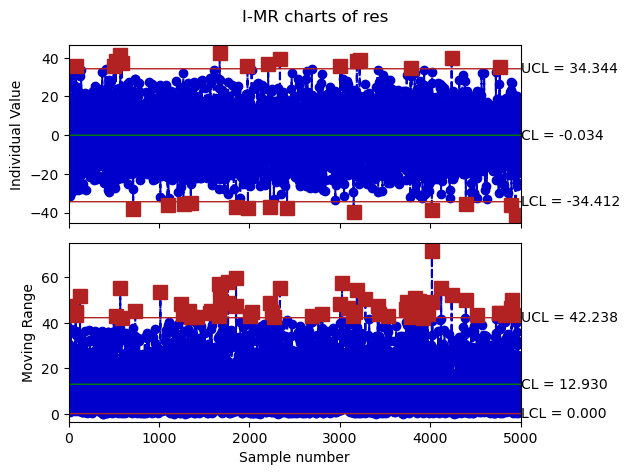

In [44]:
# Put the residuals in a dataframe
df_SCC = pd.DataFrame(model2.resid, columns=['res'])

# Plot the IMR control chart
df_SCC_IMR = qda.ControlCharts.IMR(df_SCC, 'res')

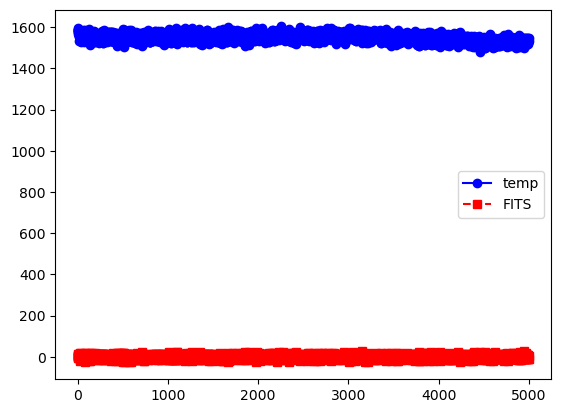

In [45]:
plt.plot(data1['temp'], color='b', linestyle='-', marker='o', label='temp')
plt.plot(model2.fittedvalues, color='r', linestyle='--', marker='s', label='FITS')
plt.legend()
plt.show()

In [61]:
data2 = model.fittedvalues

data2.head()

0       NaN
1    0.0000
2    4.1778
3    1.6235
4    7.2444
dtype: float64